# Computer vision - Lab 5

## Agenda



* description of pixels based on known image processing methods,
* selection of pixels that best describe the processed image,
* matching key points of multiple images,



## Helpers

In [2]:
# to have popular descriptors


# !pip install -U opencv-python
# !pip install opencv-contrib-python==4.5.4.58

 #opencv-contrib-python==3.4.2.16 for SIFT

In [3]:
#cv2.xfeatures2d

In [4]:
%matplotlib inline
import cv2
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import numpy as np
from numpy.lib.stride_tricks import as_strided
import PIL
from pandas import DataFrame
import pandas as pd
from IPython.display import display, HTML
from skimage.exposure import rescale_intensity
import json
import os
from itertools import product
import itertools
import random

pd.options.display.html.border = 0
pd.options.display.float_format = '{:,.2f}'.format

### Datasets

In this script we will be using:
*  Image Lenna (available at the [link](http://www.lenna.org/)) - one of the most popular images historically used for testing image processing and compression,
* ARC - The Abstraction and Reasoning Corpus (ARC) - dataset on the task of abstract reasoning by learning models ([link](https://github.com/fchollet/ARC))

In [5]:
!wget -O lena_std.tif http://www.lenna.org/lena_std.tif
!wget -O arc.zip https://github.com/fchollet/ARC/archive/refs/heads/master.zip && unzip -q -o arc.zip
!wget -O chessboard.png https://github.com/opencv/opencv/raw/master/doc/pattern.png
!wget -O clevr.jpg https://cs.stanford.edu/people/jcjohns/clevr/teaser.jpg
!wget -O graf1.png https://github.com/opencv/opencv/raw/master/samples/data/graf1.png
!wget -O graf2.png https://github.com/opencv/opencv/raw/master/samples/data/graf3.png

--2022-11-19 16:51:15--  http://www.lenna.org/lena_std.tif
Resolving www.lenna.org (www.lenna.org)... 107.180.37.106
Connecting to www.lenna.org (www.lenna.org)|107.180.37.106|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 786572 (768K) [image/tiff]
Saving to: ‘lena_std.tif’

lena_std.tif        100%[===================>] 768.14K   351KB/s    in 2.2s    

2022-11-19 16:51:17 (351 KB/s) - ‘lena_std.tif’ saved [786572/786572]

--2022-11-19 16:51:18--  https://github.com/fchollet/ARC/archive/refs/heads/master.zip
Resolving github.com (github.com)... 20.27.177.113
Connecting to github.com (github.com)|20.27.177.113|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://codeload.github.com/fchollet/ARC/zip/refs/heads/master [following]
--2022-11-19 16:51:18--  https://codeload.github.com/fchollet/ARC/zip/refs/heads/master
Resolving codeload.github.com (codeload.github.com)... 20.27.177.114
Connecting to codeload.github.com (codeload.

ARC is a dataset of **task**. A task should be understood as an element consisting of a demonstration of an input and output pair and a query for a given input what is the correct output. Together, they form something like popular intelligence tests where you must demonstrate understanding of some abstract concepts and transformations based on a **demonstration** and apply them to a **query**.

The following code loads data into a Task class object. This class contains the following fields:
* name - file name identical to the task name (unique task identifier),
* demo / test_count - number of demonstrations / queries,
* demo / test_inputs - rasters (NumPy matrices) containing input images showing the task,
* demo / test_outputs - rasters (NumPy matrices) containing output images showing the task,
* demo / test_in_sizes - input images sizes (equal to raster sizes),
* demo / test_out_sizes - output images sizes (equivalent to raster sizes).

**Note:** raster pixels contain numeric data ranging from 0-9, where specific values represent **classes**. The classes are disordered, that is, there is no **<** nor **>** operation.





In [6]:
class Task(object):
  pass
  
def load_task(dir_name, task_file):
  with open(os.path.join('./ARC-master', 'data', dir_name, task_file), 'rb') as fp:
      task = json.load(fp)

  def __parse_grid(grid):
      in_grid = np.array(grid['input'], np.int32)
      out_grid = np.array(grid['output'], np.int32)
      return in_grid, out_grid

  obj = Task()
  obj.name = os.path.basename(task_file)
  obj.demo_count, obj.test_count = len(task['train']), len(task['test'])
  obj.demo_inputs, obj.demo_outputs = list(zip(*map(__parse_grid, task['train'])))
  obj.demo_in_sizes, obj.demo_out_sizes = [i.shape for i in obj.demo_inputs], [i.shape for i in obj.demo_outputs]
  obj.test_inputs, obj.test_outputs = list(zip(*map(__parse_grid, task['test'])))
  obj.test_in_sizes, obj.test_out_sizes = [i.shape for i in obj.test_inputs], [i.shape for i in obj.test_outputs]
  return obj

In [7]:
def imshow(a):
  a = a.clip(0, 255).astype('uint8')
  if a.ndim == 3:
    if a.shape[2] == 4:
      a = cv2.cvtColor(a, cv2.COLOR_BGRA2RGBA)
    else:
      a = cv2.cvtColor(a, cv2.COLOR_BGR2RGB)
  display(PIL.Image.fromarray(a))

In [8]:
css = """
<style type="text/css">
  table, td, table.dataframe, table.dataframe td { 
    border: 1px solid black;    //border: double;
    border-collapse: collapse;
    border-style: solid;
    border-spacing: 0px;
    background-color: rgb(250,250,250);
    width: 18px;
    height: 18px;
    text-align: center;
    transform: scale(1.0);
    margin: 2px;
    }
</style>
"""

def h(s):
  return display(HTML(css + DataFrame(s).to_html(header=False, index=False)))

In [9]:
def h_color(a, cmap='gray', scale=2):
  s = [a.shape[0] * scale, a.shape[1] * scale]
  plt.figure(figsize=s)
  plt.tick_params(
    axis='both', which='both',
    bottom=False, top=False,
    labelbottom=False, labelleft=False, left=False, right=False
  )
  plt.imshow(a, cmap=cmap)

In [10]:
cmap = ListedColormap([
    'black', 'tomato', 'chocolate', 'darkorange',
    'gold', 'olive', 'green', 'deepskyblue',
    'blueviolet', 'hotpink'
])

def h_grid(grid, scale=1):
  h_color(grid, cmap, scale)

# Pixel description (Classic)

An intensity-domain 2D image is a 2D projection of a 3D scene in which the image is represented as a 2D matrix containing pixels. There are many equivalent notations such as RGB, CMYK, HSV, etc., in which each pixel is written in a different way (using different representations).

Accordingly, each representation of a 3D scene is a description of the incident light on the camera matrix, so pixels should be treated as **descriptors** of the light incident on a given element.

As each pixel is a descriptor of a certain element in the scene (from which incident light is reflected), it seems true to say that neighboring pixels in the intensity domain are correlated with each other and there is a cause-and-effect relationship between them. **The above interpretation has become the basis for the development of countless methods of pixel description based on its and its neighborhood representation, in order to analyze the content of the 3D scene.**

We will call any operation that describes a given pixel or its relationship to a neighborhood a **descriptor**. The term **descriptor(pixel)** is also used in reference to the value that the descriptor (operation) returns.
In other words, a descriptor is a set of features describing a given object (the whole image, single pixels) or a function that creates these features.




## Building descriptors of simple features

By loading an image into memory in the form of a 2D raster, we obtain the first, one of the simpler descriptors. Each pixel is described with 3 values determining the "content" of blue, green and red colors.


Each pixel is described by 3 values (512, 512, 3) [113 131 226]


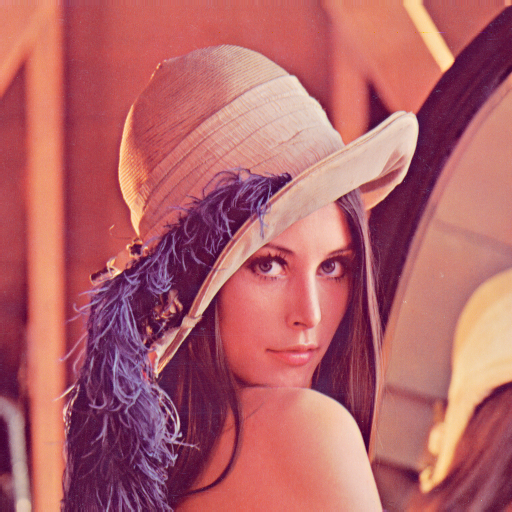

In [11]:
lena = cv2.imread('./lena_std.tif', 1)

print('Each pixel is described by 3 values', lena.shape, lena[10, 10])
imshow(lena)

Another descriptor may be the form "grayscale", in which each pixel has an associated grayscale value. It is one value between 0-255.

Each pixel is described by 1 value (512, 512) 157


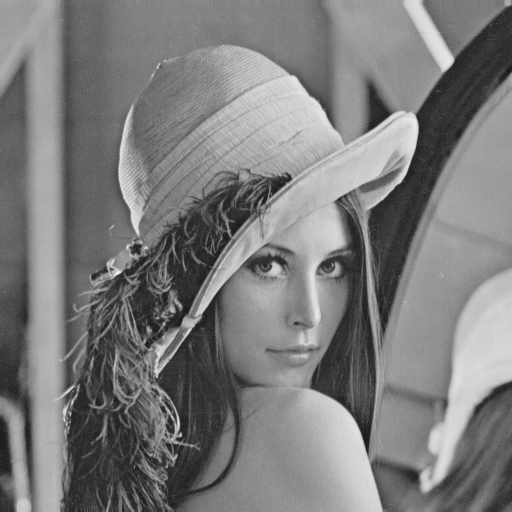

In [12]:
lena_gray = cv2.cvtColor(lena, cv2.COLOR_BGR2GRAY)

print('Each pixel is described by 1 value', lena_gray.shape, lena_gray[10, 10])
imshow(lena_gray)

Having many descriptors for a given pixel, we can combine them or create new descriptors based on them. One of the simpler operations of folding descriptors is to append values from all descriptors to form one longer vector.

Below is presented a descriptor that combines an image in BGR and Grayscale space, as a result describing each pixel with four values (Blue, Green, Red, Grayscale).


In [13]:
def simpliest_possible_descriptor(img):
  img_grayscale = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)[..., np.newaxis]
  return np.concatenate([img, img_grayscale], -1)

In [14]:
lena_spd = simpliest_possible_descriptor(lena)
print('Each pixel is described by 4 values', lena_spd.shape, lena_spd[10, 10])

Each pixel is described by 4 values (512, 512, 4) [113 131 226 157]


From the previously known (convolutional) image filtering methods, we can distinguish low-pass and high-pass filters. Below is an example of creating two descriptors composed of low pass and high pass filter values.


In [15]:
def high_pass_filter_descriptor(img):
  img_grayscale = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
  img_laplacian = cv2.Laplacian(img_grayscale, cv2.CV_32F)
  img_sobel = cv2.Sobel(img_grayscale, cv2.CV_32F, 1, 1, ksize=3)
  return np.stack([img_laplacian, img_sobel], -1)

def low_pass_filter_descriptor(img):
  img_grayscale = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
  img_blur = cv2.blur(img_grayscale, (3, 3))
  img_gaussian_blur = cv2.GaussianBlur(img_grayscale, (5, 5), 0)
  img_median = cv2.medianBlur(img_grayscale, 5)
  img_bilateral = cv2.bilateralFilter(img_grayscale, 9, 75, 75)
  return np.stack([img_blur, img_gaussian_blur, img_median, img_bilateral], -1)

In [16]:
lena_lpf = low_pass_filter_descriptor(lena)
print('Low pass filter descriptor:', lena_lpf.shape, lena_lpf[10, 10])

lena_hpf = high_pass_filter_descriptor(lena)
print('High pass filter descriptor:', lena_hpf.shape, lena_hpf[10, 10])

Low pass filter descriptor: (512, 512, 4) [157 157 157 157]
High pass filter descriptor: (512, 512, 2) [-2. -4.]


Descriptors can be based on any operation. These can be both complex operations based on machine learning systems, as well as precise algorithms describing specific, previously known concepts.

For the example of an image (any image) in ARC below, the method below describes the neighborhood of a given pixel.



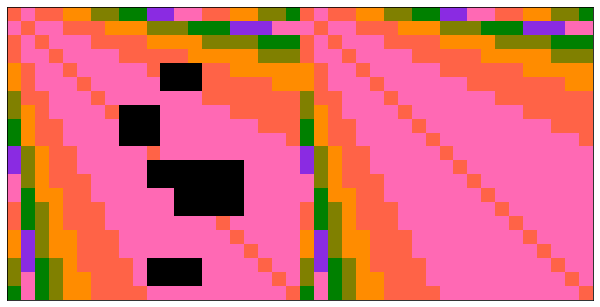

In [17]:
p_73251a56 = load_task('training', '73251a56.json')
h_grid(np.concatenate([p_73251a56.demo_inputs[0], p_73251a56.demo_outputs[0]], 1), scale=0.5)

The method consists in checking if the adjacent pixel (with the given location) is the same as the central pixel.

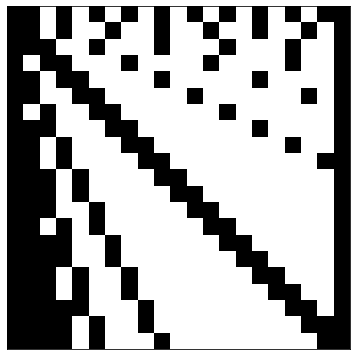

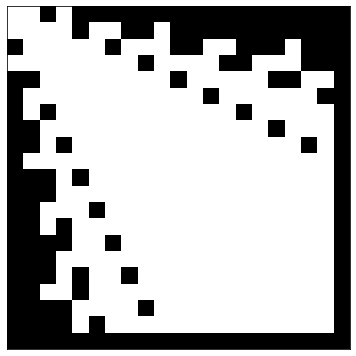

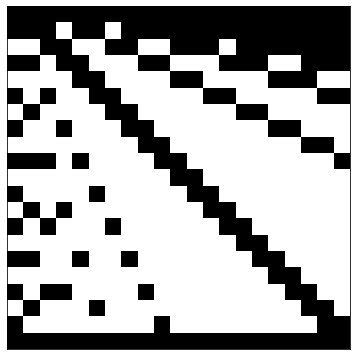

In [18]:
def check_neighbour(img, pos, neighbourhood_size=3):
  # parameters requirements
  assert neighbourhood_size % 2 == 1
  center = int((neighbourhood_size - 1) / 2)
  assert pos[0] != 0 or pos[1] != 0
  assert (0 <= center + pos[0] < neighbourhood_size) and (0 <= center + pos[1] < neighbourhood_size)

  # prepare filter for conv2d where center pixel == -1 and selected neighbour == 1
  kernel = np.zeros([neighbourhood_size, neighbourhood_size])
  kernel[center, center] = -1
  kernel[center + pos[0], center + pos[1]] = 1

  # perform conv2d and find pixels where center + neighbour == 0
  img_n = cv2.filter2D(img.astype(np.float32), -1, kernel.astype(np.float32), borderType=cv2.BORDER_ISOLATED)
  img_n = (img_n == 0)

  return img_n


h_color(check_neighbour(p_73251a56.demo_outputs[0], (0, 1)).astype(np.uint8), scale=0.3)
h_color(check_neighbour(p_73251a56.demo_outputs[0], (1, 1)).astype(np.uint8), scale=0.3)
h_color(check_neighbour(p_73251a56.demo_outputs[0], (1, 0)).astype(np.uint8), scale=0.3)

### Task 1

For any ARC image, suggest a descriptor that will calculate the number of the same adjacent pixels as the center pixel.

Then find the pixels they will have:
- exactly 4 same neighbors,
- more than 4 same neighbors

Parameters:
- create a 3x3 neighborhood





A pixel descriptor that specifies the number of identical neighbors:


1,2,2,2,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0
2,4,4,3,2,3,3,1,2,2,1,2,1,1,2,1,1,2,1,1,1
2,4,2,5,5,4,3,4,4,4,2,2,3,3,1,2,2,2,1,2,1
2,3,5,2,6,6,6,4,4,5,4,3,1,3,3,3,4,4,2,2,1
1,2,5,6,2,6,7,7,6,4,3,3,5,3,3,4,4,4,4,4,3
1,3,4,6,6,2,6,7,8,7,5,3,5,3,5,7,6,5,4,4,3
1,3,3,6,7,6,2,5,5,5,5,5,5,4,3,6,7,8,7,6,3
1,1,4,4,7,7,6,1,3,5,3,6,8,7,6,4,4,6,7,8,5
1,2,4,4,6,8,7,4,5,8,5,5,8,8,8,7,6,4,4,6,4
1,2,4,5,4,7,8,6,3,5,3,5,8,8,8,8,8,7,6,4,2
1,1,2,5,4,6,8,7,6,3,0,3,5,5,5,5,6,7,8,7,4



Input raster and descriptors found


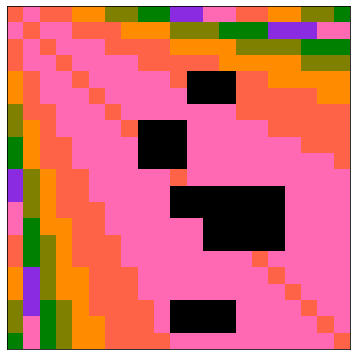

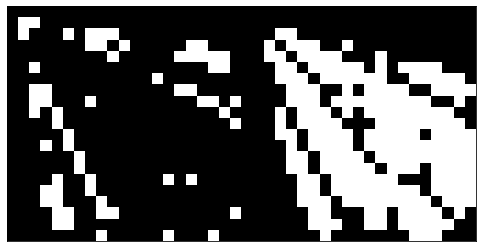

In [520]:
from numpy.lib.stride_tricks import sliding_window_view
def neighbourhood_descriptor(img):
    h, v = img.shape
    output = np.zeros((h, v), dtype=np.uint8)

    for row in range(h):
      for col in range(v):
          neighbors = img[max(0, row - 1): min(row + 2, h), max(0, col - 1): min(col + 2, v)]
          output[row, col] = np.sum(neighbors == img[row, col]) - 1
  
    return output


demo_output = p_73251a56.demo_inputs[0]
demo_output_n = neighbourhood_descriptor(demo_output)
demo_output_n
print('A pixel descriptor that specifies the number of identical neighbors:')
h(demo_output_n)

print('\nInput raster and descriptors found')
h_grid(demo_output, scale=0.3)
h_color(np.concatenate([demo_output_n == 4, demo_output_n > 4], 1), scale=0.4)

## Detection and matching of key points

Computing descriptors for each pixel is often inefficient and very time consuming. Often there are areas that contain exactly the same pixels. The solution is to find characteristic points in the picture called **key points**.
Key points are places that are unique to an image. Their presence allows you to describe the image and **compare it with other images**.

Comparing images with each other based on key points is called keypoint matching. It involves comparing the key points from both images (peer to peer) and finding for each of the input key points the closest key point from the second image). In this arrangement, one image is treated as a query (input).

There is also a variant where we find **multiple matches** for each input key point.


### Detection of key points

The key point detection mechanism is closely related to the descriptor itself. For example, for the Laplasian edge detection, it can be proposed to find pixels with extreme values (e.g. -4 and 4).

For an ARC image, let's define a descriptor that counts adjacent pixels **different** from the center pixel.

** Note: The descriptor is based on the solution of Task 1. **

In [22]:
def not_neighbourhood_descriptor(img):
  return 8 - neighbourhood_descriptor(img)

p_73251a56_in0 = p_73251a56.demo_inputs[0]
p_73251a56_in0_nn = not_neighbourhood_descriptor(p_73251a56_in0)

print('Pixel descriptor specifying the number of different neighbors:')
h(p_73251a56_in0_nn)

Pixel descriptor specifying the number of different neighbors:


7,6,6,6,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,8
6,4,4,5,6,5,5,7,6,6,7,6,7,7,6,7,7,6,7,7,7
6,4,6,3,3,4,5,4,4,4,6,6,5,5,7,6,6,6,7,6,7
6,5,3,6,2,2,2,4,4,3,4,5,7,5,5,5,4,4,6,6,7
7,6,3,2,6,2,1,1,2,4,5,5,3,5,5,4,4,4,4,4,5
7,5,4,2,2,6,2,1,0,1,3,5,3,5,3,1,2,3,4,4,5
7,5,5,2,1,2,6,3,3,3,3,3,3,4,5,2,1,0,1,2,5
7,7,4,4,1,1,2,7,5,3,5,2,0,1,2,4,4,2,1,0,3
7,6,4,4,2,0,1,4,3,0,3,3,0,0,0,1,2,4,4,2,4
7,6,4,3,4,1,0,2,5,3,5,3,0,0,0,0,0,1,2,4,6
7,7,6,3,4,2,0,1,2,5,8,5,3,3,3,3,2,1,0,1,4


A key point is one where the neighbors have great variety in color, class from the key point.
Let's only select pixels that have at least 6 different pixels and are not at the border of the image.


In [23]:
p_73251a56_in0_sel = p_73251a56_in0_nn >= 7
p_73251a56_in0_sel[0, :] = False
p_73251a56_in0_sel[-1, :] = False
p_73251a56_in0_sel[:, 0] = False
p_73251a56_in0_sel[:, -1] = False

print('Key points (matrix):')
h(p_73251a56_in0_sel.astype(np.uint8))

kp = np.where(p_73251a56_in0_sel)

print('\nKey pointse (x, y):')
print('Number of key points:', len(kp[0]))
print('x:', kp[0])
print('y:', kp[1])

Key points (matrix):


0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,1,0,0,1,0,1,1,0,1,1,0,1,1,0
0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0
0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0



Key pointse (x, y):
Number of key points: 24
x: [ 1  1  1  1  1  1  1  1  2  2  3  7  7 10 10 12 13 14 15 15 16 18 18 19]
y: [ 7 10 12 13 15 16 18 19 14 18 12  1  7  1 10  1  1  2  1 15  1  1  2  1]


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


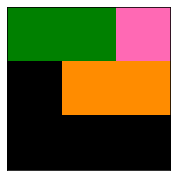

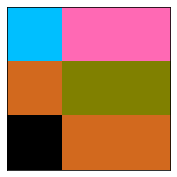

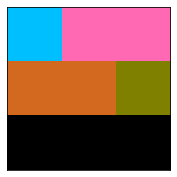

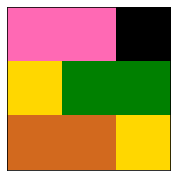

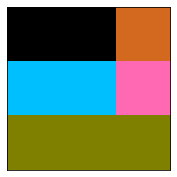

...

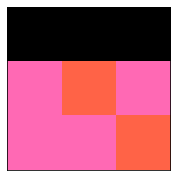

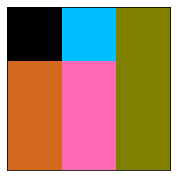

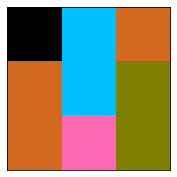

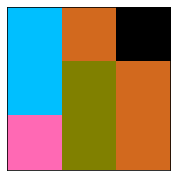

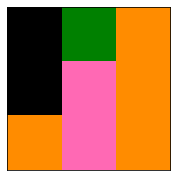

In [24]:
for xi, yi in zip(*kp):
  h_grid(p_73251a56_in0[xi - 1:xi + 2, yi - 1: yi + 2])

### Matching key points

Next, let's define another descriptor which is a vector of its neighbors.

In [25]:
def copy_descriptor(arr):
  shape = list(arr.shape)
  arr = np.pad(arr,1,"constant")  
  nDims = len(arr.shape)
  
  newStrides = arr.strides + arr.strides
  return as_strided(arr, shape=shape+[3,3], strides=newStrides).reshape(shape+[9])

p_73251a56_in0_nncopy = copy_descriptor(p_73251a56_in0)

print('Sample pixel neighbors')
print(p_73251a56_in0[0:3, 0:3])

print('\nPixel descriptor with position (1, 1) containing its neighborhood')
print(p_73251a56_in0_nncopy[1, 1])

Sample pixel neighbors
[[1 6 1]
 [6 1 6]
 [1 6 1]]

Pixel descriptor with position (1, 1) containing its neighborhood
[1 6 1 6 1 6 1 6 1]



For all detected key points in the previous section, let's get the corresponding descriptors as calculated above.

In [26]:
desc = np.stack([p_73251a56_in0_nncopy[xi, yi] for xi, yi in zip(*kp)], 0)

Now let's perform analogous transformations for another image from the same ARC task.

In [27]:
p_73251a56_out0 = p_73251a56.demo_outputs[0]
p_73251a56_out0_nn = not_neighbourhood_descriptor(p_73251a56_out0)
p_73251a56_out0_sel = p_73251a56_out0_nn >= 7
p_73251a56_out0_sel[0, :] = False
p_73251a56_out0_sel[-1, :] = False
p_73251a56_out0_sel[:, 0] = False
p_73251a56_out0_sel[:, -1] = False

p_73251a56_out0_nncopy = copy_descriptor(p_73251a56_out0)

kp_ = np.where(p_73251a56_out0_sel)
desc_ = np.stack([p_73251a56_out0_nncopy[xi, yi] for xi, yi in zip(*kp_)], 0)

print('\nKey points (x, y):')
print('Number of key points:', len(kp_[0]))
print('x:', kp_[0])
print('y:', kp_[1])


Key points (x, y):
Number of key points: 20
x: [ 1  1  1  1  1  1  1  1  2  2  7 10 12 13 14 15 16 18 18 19]
y: [ 7 10 12 13 15 16 18 19 14 18  1  1  1  1  2  1  1  1  2  1]


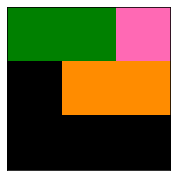

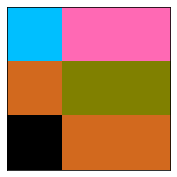

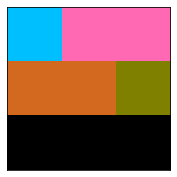

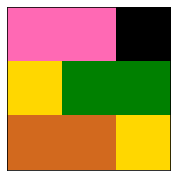

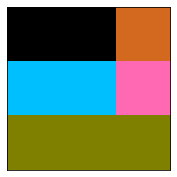

...

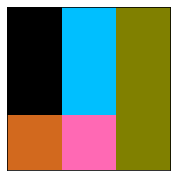

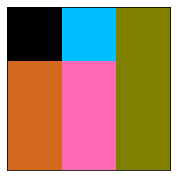

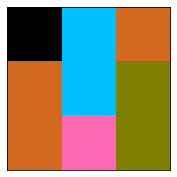

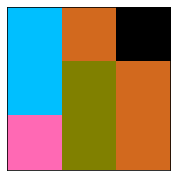

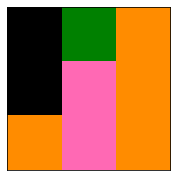

In [28]:
for xi, yi in zip(*kp_):
  h_grid(p_73251a56_out0[xi - 1:xi + 2, yi - 1: yi + 2])

Thus, for 2 images we found its key points and we calculated an additional descriptor that should describe a given pixel and its surroundings well.

The next step in the matching mechanism is to define the matching function. The matching function is strictly dependent on how the descriptor works. For data in the same space, a **distance / similarity function** of the two descriptors can be proposed (e.g. if the data is in a Euclidean space, the Euclidean distance of the two vectors can be computed).

For the above configuration, in which the pixel descriptor is its adjacent pixels arranged in a certain order, we can propose a similarity function that computes what percentage of the components of the two descriptors is the same.


In [29]:
def nn_sim(desc1, desc2):
  return (desc1 == desc2).mean(-1)

a = np.array([0, 5, 2, 4, 9])
b = np.array([0, 5, 1, 4, 0])

print(nn_sim(a, b))
print(nn_sim(a, a))

0.6
1.0


In [30]:
desc_sim = nn_sim(desc[:, np.newaxis], desc_[np.newaxis])
print('The size of the similarity matrix:', desc_sim.shape)

print('\nSimilarities for the first input key point:')
print(desc_sim[0])

desc_nearest = np.argmax(desc_sim, -1)
desc_nearest_sim = np.max(desc_sim, -1)
print('\nBest matches:', desc_nearest)
print('\nBest matches similarities:', desc_nearest_sim)

The size of the similarity matrix: (24, 20)

Similarities for the first input key point:
[1.         0.11111111 0.         0.         0.         0.
 0.11111111 0.33333333 0.11111111 0.         0.33333333 0.11111111
 0.22222222 0.33333333 0.11111111 0.11111111 0.         0.
 0.11111111 0.22222222]

Best matches: [ 0  1  2  3  4  5  6  7  8  9 14 10  2 11 12 12 13 14 15 12 16 17 18 19]

Best matches similarities: [1.         1.         1.         1.         1.         1.
 1.         1.         1.         1.         0.33333333 1.
 0.22222222 1.         0.22222222 1.         1.         1.
 1.         0.22222222 1.         1.         1.         1.        ]


Similarity: 1.0
Similarity: 1.0
Similarity: 1.0
Similarity: 1.0
Similarity: 1.0
Similarity: 1.0
Similarity: 1.0
Similarity: 1.0
Similarity: 1.0
Similarity: 1.0
Similarity: 0.3333333333333333
Similarity: 1.0
Similarity: 0.2222222222222222
Similarity: 1.0
Similarity: 0.2222222222222222
Similarity: 1.0
Similarity: 1.0
Similarity: 1.0
Similarity: 1.0
Similarity: 0.2222222222222222
Similarity: 1.0
Similarity: 1.0
Similarity: 1.0
Similarity: 1.0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


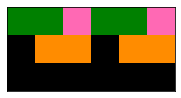

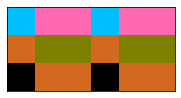

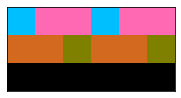

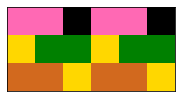

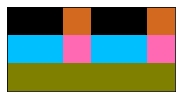

...

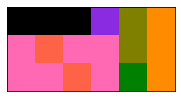

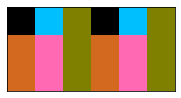

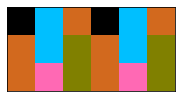

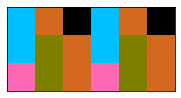

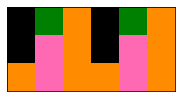

In [31]:
for xi, yi, nearest, nearest_sim in zip(*kp, desc_nearest, desc_nearest_sim):
  xi_, yi_ = kp_[0][nearest], kp_[1][nearest]

  query = p_73251a56_in0[xi - 1:xi + 2, yi - 1: yi + 2] 
  match = p_73251a56_out0[xi_ - 1:xi_ + 2, yi_ - 1: yi_ + 2]

  print('Similarity:', nearest_sim)
  h_grid(np.concatenate([query, match], 1))
  

For the above results, the following facts can be noted:
- each input key point has **always** assigned a key point from the second image,
- the best matches may be low in terms of similarities,
- not necessarily each of the key points from the second image is an mapping to any input key point or it can be mapped to several input key points.

Therefore, matches should only occur if the similarity is greater than a certain threshold.


In [32]:
threshold = 0.7

matches = [(i, j) for i, j in zip(range(len(desc_nearest)), desc_nearest) if desc_nearest_sim[i] > threshold]

print(len(matches))
print(matches)

20
[(0, 0), (1, 1), (2, 2), (3, 3), (4, 4), (5, 5), (6, 6), (7, 7), (8, 8), (9, 9), (11, 10), (13, 11), (15, 12), (16, 13), (17, 14), (18, 15), (20, 16), (21, 17), (22, 18), (23, 19)]


Let's define additional information for the similarity of the two images:
- number of input key points that have matches,
- the number of reference key points that are matches,

In [33]:
in_kp_score = len(matches) / len(kp[0])
ref_kp_score = len(set([j for _, j in matches])) / len(kp_[0])

print(in_kp_score)
print(ref_kp_score)

0.8333333333333334
1.0


Finally, to find out if the images are similar or not, you can add a condition on the similarity statistics calculated above. The simplest condition will be the cut off condition:

In [34]:
is_similar = in_kp_score > 0.8 and ref_kp_score > 0.8
print(is_similar)

True


## Task 2


Write an algorithm that finds all similar images for the input image (query) and the reference image set. The algorithm should specify the following steps:
- computing descriptors for all pixels,
- determination of key points,
- transformation of the query image into a list of key points and their descriptors,
- transformation of the reference image set into a set of lists of key points and their descriptors,
- matching the key points of the query and the reference image and determining the similarity,
- displaying the most similar image from the reference set

**Note:**
- the algorithm can use the materials presented in the sections above,
- it is not allowed to use ready-made descriptors implementations available in the OpenCV library (you need to prepare the descriptors yourself),
- mainly, the performance of the whole operation of finding similar images will be assessed (building a good descriptor can be very demanding),
- as a data set, you can take input images from several ARC task as a reference set, and any **other** ARC image as a query.




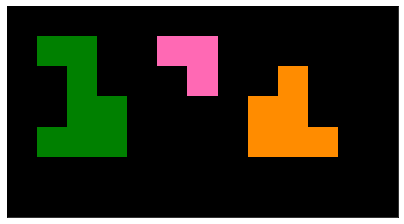

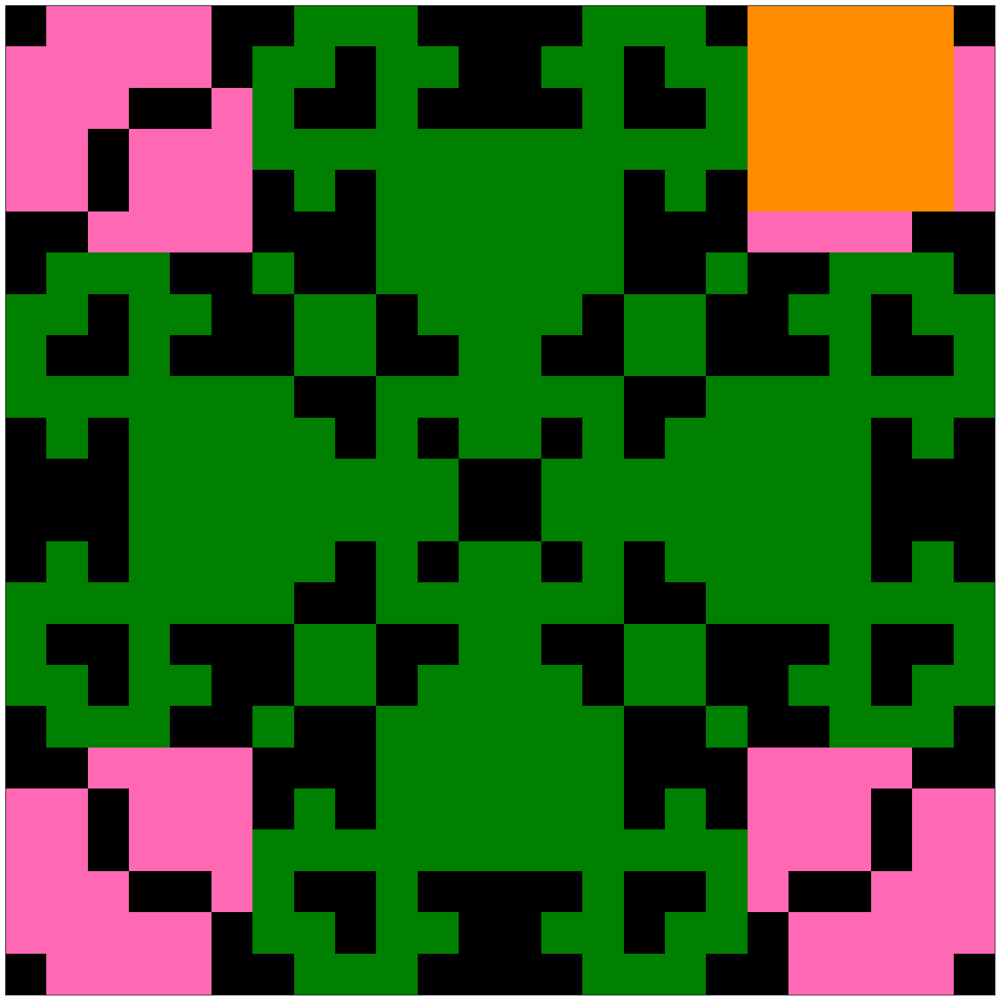

In [36]:
import glob

def get_kp_and_desc(img):
    diff_pixel = not_neighbourhood_descriptor(img)

    sel_pixel = diff_pixel >= 5
    sel_pixel[0, :] = False
    sel_pixel[-1, :] = False
    sel_pixel[:, 0] = False
    sel_pixel[:, -1] = False

    kp = np.where(sel_pixel)
    desc = np.stack([copy_descriptor(img)[xi, yi] for xi, yi in zip(*kp)], 0)

    return desc, kp


def find_similar(img1, img2):

    desc = get_kp_and_desc(img1)[0]
    desc_ = get_kp_and_desc(img2)[0]
    kp = get_kp_and_desc(img1)[1]
    kp_ = get_kp_and_desc(img2)[1]

    desc_sim = nn_sim(desc[:, np.newaxis], desc_[np.newaxis])
    desc_nearest = np.argmax(desc_sim, -1)
    desc_nearest_sim = np.max(desc_sim, -1)

    return sum(desc_nearest_sim)


all_files = glob.glob('./ARC-master/data/training/*.json')
query_image_dir = load_task('training', os.path.basename(random.choice(all_files)))
query_image = query_image_dir.demo_inputs[0]

dataset = list()
for i in range(5):
    check = load_task('training', os.path.basename(all_files[i]))
    list(map(dataset.append, check.demo_inputs))

sims = dict()
for idx, ref in enumerate(dataset):
    sims[idx] = find_similar(query_image, ref)

most_sim = max(sims, key=sims.get)

h_grid(query_image)
h_grid(dataset[most_sim])

# Pixel description (OpenCV)

The OpenCV library contains a set of implementations of popular descriptors and additional functionalities for finding matches and for displaying processing results.

## Popular OpenCV Descriptors

Each of the descriptors in the OpenCV library has the following functions:
- detect () - to detect key points (unless the implementation does not have such functionality),
- compute () - to compute descriptors for key points,
- detectAndCompute () - function that returns key points and their descriptors for a given image (single-line calling of the above operations).



### Harris Corner Detector

Algorithm presented in the scientific article 'A Combined Corner and Edge Detector' in 1988 by authors Chris Harris and Mike Stephens.

The algorithm uses the sum of the changes in the intensity of adjacent pixels to find flat areas, edges, and corners. The first step in finding these areas is to expand the formula for the above sum into a Taylor series and then calculate a value based on the determinant and trace of the gradient matrix, which will directly indicate the classification of the area.



1. The sum of the intensities of adjacent pixels:
$$E(u,v) = \sum_{x,y} w(x,y) \, [I(x+u,y+v)-I(x,y)]^2$$
2. Expansion with Taylor series:
$$E(u,v) \approx \begin{bmatrix} u & v \end{bmatrix} M \begin{bmatrix} u \\ v \end{bmatrix}$$
$$M = \sum_{x,y} w(x,y) \begin{bmatrix}I_x I_x & I_x I_y \\ I_x I_y & I_y I_y \end{bmatrix}$$
3. Calculation of the final value:

$$R = det(M) - k(trace(M))^2$$
$$det(M) = \lambda_1 \lambda_2$$
$$trace(M) = \lambda_1 + \lambda_2$$


Determining whether a given area is a corner, edge or flat area is made in accordance with the following:

- if R is close to zero - the area is flat,
- if R is (much) less than zero, the area is an edge,
- if R is (much) greater than zero - area is a corner


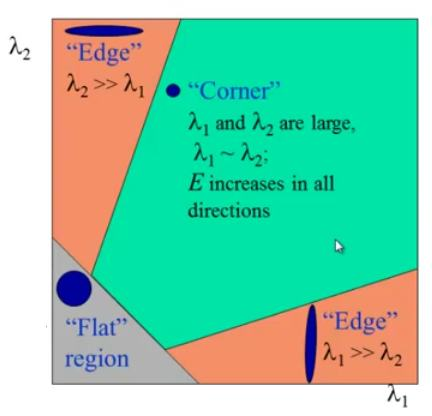

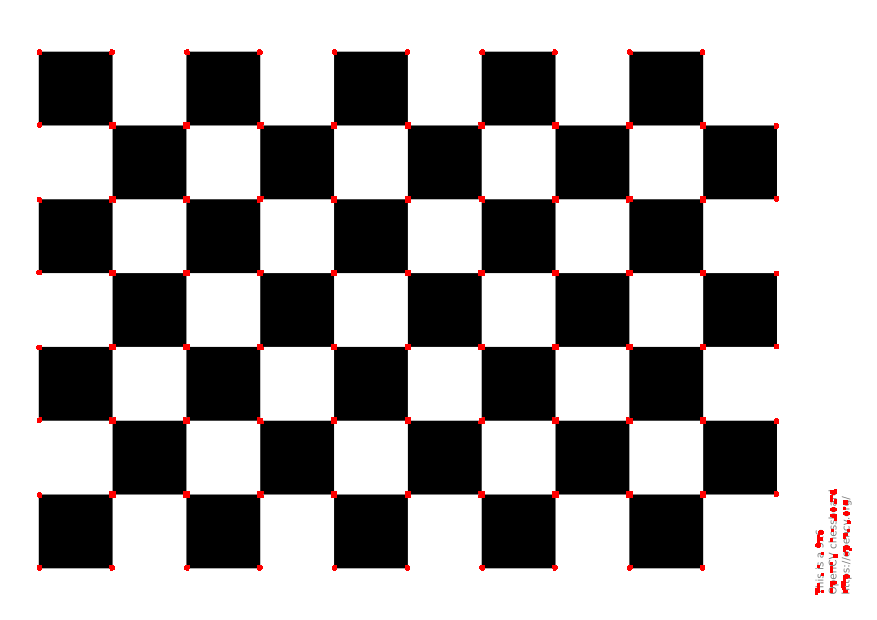

In [37]:
img_blocks = cv2.imread('chessboard.png', cv2.IMREAD_COLOR)
img_blocks = cv2.resize(img_blocks, None, fx=.5, fy=.5)
img_blocks_gray = cv2.cvtColor(img_blocks, cv2.COLOR_BGR2GRAY)
img_blocks_gray = img_blocks_gray.astype(np.float32)

dst = cv2.cornerHarris(img_blocks_gray, 3, 3, 0.04)
#result is dilated for marking the corners, not important
dst = cv2.dilate(dst,None)

# Threshold for an optimal value, it may vary depending on the image.
img_blocks[dst > 0.01*dst.max()]=[0,0,255]
imshow(img_blocks)

### SIFT - Scale Invariant Feature Transform

The author of the algorithm is D.Lowe, who presented it for the first time in the work Distinctive Image Features from Scale-Invariant Keypoints in 2004.

It is an algorithm that determines key points and their descriptors based on gradients in their close surroundings. The next steps of the algorithm are as follows:

1. The input image is scaled multiple times (eg x2, x4, x8, x16) and then Gauss filters are made on each scale (eg size 2, 4, 6, 8).

2. The difference operation is performed between neighboring Gaussians in a given scale (directly on the image intensities).


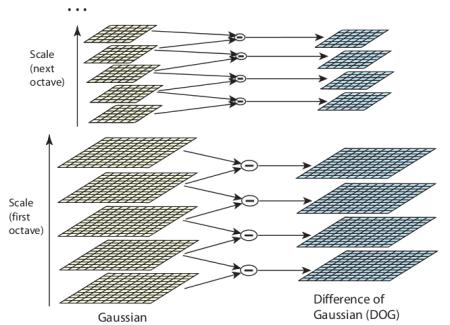

3. Each pixel is compared with its surroundings (eg 8 neighboring pixels - 3x3) and it is checked if a given pixel is an extreme value.

4. Similarly, the same pixel is compared with the pixels on a lower and higher scale (scale = Gaussian filter size).


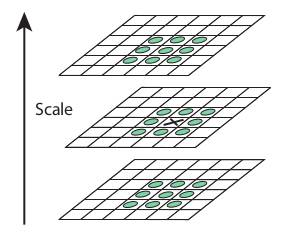

5. The extreme end values are **key point candidates**. To select key points, an additional filtering operation is performed based on the contrast of the pixel's surroundings.

6. For key points, their surroundings are selected and gradients are calculated for each surrounding pixel. These gradients are aggregated with respect to their surroundings in **histograms**.


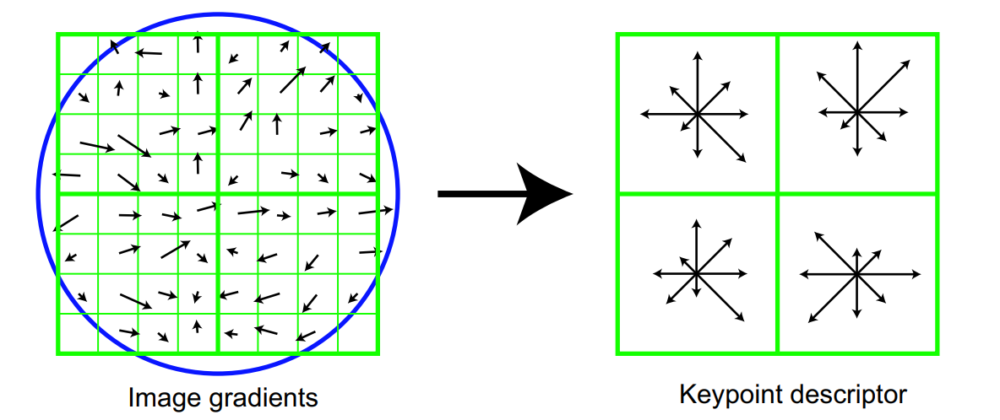

7. On the histograms, **discretization** is performed by dividing the histogram eg every 45 degrees, which results in 8 values.

8. The final step is to combine all values from the environment into one final descriptor. For the illustration above, we have 4 **mini-regions** and each will have 8 values. Ultimately, the descriptor will have a size of 32 (each key point will have 32 values).


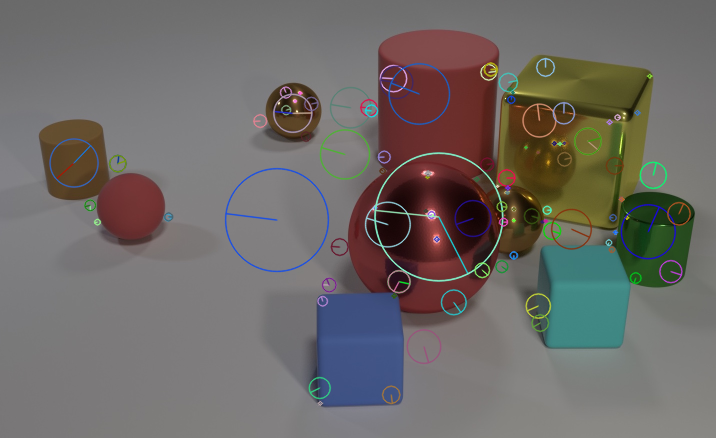

(123, 128)
[ 51.  10.   1.  25.  50.   1.   0.  17.  16.  35.  77. 151. 150.   9.
   0.   0. 131. 145.  65.  17.   6.   1.   0.   4.  19.  10.   1.   1.
   4.   6.   2.   4.  10.  33.  27.  20.  78.   5.   0.   7.  52.  11.
   6.  38. 151.  65.   8.  12. 151.  49.   3.   3.  33.  11.   7.  57.
  59.   5.   0.   0.   0.   6.   5.  11.   0.  56.  49.  11.  22.   4.
   0.   0.  10.  12.  12.  12. 127. 110.  73.  45. 116.   4.   0.   0.
   8.  18.  55. 151.  20.   1.   0.   0.   0.   0.   0.   8.   0.  24.
  22.   0.   0.   0.   0.   0.   2.  46.  20.   0.   1.   5.   9.   6.
   4.   6.   1.   0.   0.   1.   6.  13.   0.   0.   0.   0.   0.   0.
   0.   0.]


In [163]:
img_clevr = cv2.imread('clevr.jpg', cv2.IMREAD_COLOR)
img_clevr = cv2.resize(img_clevr, None, fx=0.5, fy=0.5)
img_clevr_gray = cv2.cvtColor(img_clevr, cv2.COLOR_BGR2GRAY)

sift = cv2.SIFT_create()
kp, desc = sift.detectAndCompute(img_clevr_gray, None)

img_clevr = cv2.drawKeypoints(img_clevr, kp, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
imshow(img_clevr)

print(desc.shape)
print(desc[0])

### BRIEF - Binary Robust Independent Elementary Features

The algorithm proposed in the research paper '' BRIEF: Binary Robust Independent
Elementary Features '' by the authors Michael Calonder, Vincent Lepetit, Christoph Strecha, and Pascal Fua.

The algorithm is used to calculate descriptors for a given pixel and its surroundings and does not include the stage of key point detection, so it must always be applied to known (previously discovered) key points.

The algorithm is as follows:

1. For a given neighborhood size (eg 3, 3), **n** random pairs are selected.


In [39]:
h([
   [0, 1, 2],
   [3, 4, 5],
   [6, 7, 8]
])

0,1,2
3,4,5
6,7,8


In [40]:
n = 10

# all combinations
p = list(itertools.combinations(range(9), 2))

# only n random combinations
p = random.sample(p, n)

print(p)

[(3, 4), (0, 5), (2, 6), (3, 5), (0, 2), (1, 5), (1, 3), (5, 8), (0, 8), (6, 7)]


2. The neighborhood of the key point is selected.

In [41]:
x = np.array([
  [255, 100, 0],
  [20, 0, 100],
  [10, 255, 10]
])
h(x)

255,100,0
20,0,100
10,255,10


3. For the key point, it is checked if the values from the previously selected pairs of neighbors are the same (greater).

In [42]:
x_flat = np.reshape(x, -1)
pairs = [(x_flat[pi[0]], x_flat[pi[1]]) for pi in p]

print('The values of all par:')
print(pairs)

bin_vals = [x == y for x, y in pairs]

print('\nThe compliance of the pixel values of par of neighbours:')
print(bin_vals)

brief_desc = np.array(bin_vals, np.int32)

print('\nFinal brief descriptor:')
print(brief_desc)

The values of all par:
[(20, 0), (255, 100), (0, 10), (20, 100), (255, 0), (100, 100), (100, 20), (100, 10), (255, 10), (10, 255)]

The compliance of the pixel values of par of neighbours:
[False, False, False, False, False, True, False, False, False, False]

Final brief descriptor:
[0 0 0 0 0 1 0 0 0 0]


#### BRIEF in OpenCV

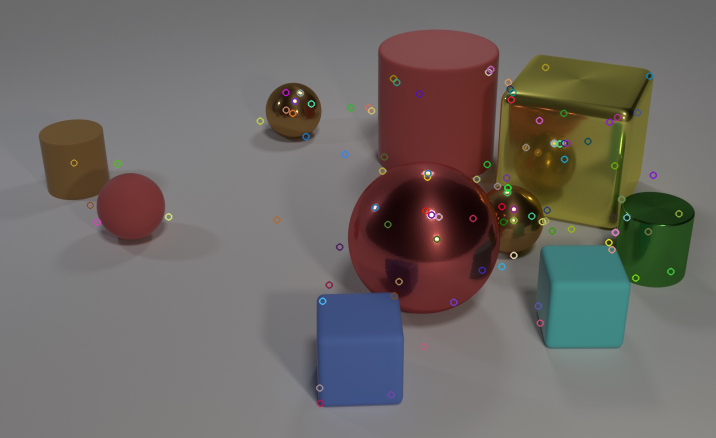


The size of the descriptor in bytes: 32
The number of random pairs of comparisons: 256


In [43]:
img_clevr = cv2.imread('clevr.jpg', cv2.IMREAD_COLOR)
img_clevr = cv2.resize(img_clevr, None, fx=0.5, fy=0.5)
img_clevr_gray = cv2.cvtColor(img_clevr, cv2.COLOR_BGR2GRAY)

sift = cv2.SIFT_create()
brief = cv2.xfeatures2d.BriefDescriptorExtractor_create(bytes=32)
kp = sift.detect(img_clevr_gray, None)
kp, desc = brief.compute(img_clevr_gray, kp)

img_clevr = cv2.drawKeypoints(img_clevr, kp, None, flags=cv2.DRAW_MATCHES_FLAGS_DEFAULT)
imshow(img_clevr)

print('\nThe size of the descriptor in bytes:', brief.descriptorSize())
print('The number of random pairs of comparisons:', brief.descriptorSize() * 8)

The OpenCV implementation operates on bits, but the data (due to the specificity of Python) are returned in the form of bytes. This means that if when creating the descriptor we choose its size as 32 bytes, the BRIEF will look for 256 pairs for each pixel neighborhood.

The result will be returned in bytes (which makes no difference, because the descriptors are compared with Hamming distance).

In [44]:
print(desc.shape)
print(desc[0])

(123, 32)
[231 254 149  26 243  86 254 102 101 130 143  87 151  41  81  35 150  48
  76  62 174  40  40 175 223 191 181 149  36 188 172 208]


### FAST - Features from Accelerated Segment Test

Algorithm for corner detection by means of a simple and quick test of the pixel's surroundings. Proposed in the paper 'Machine learning for high-speed corner detection' by Edward Rosten and Tom Drummond.

This approach is characterized by a very short duration of action and a relatively high effectiveness of action.

The algorithm performs the following operations:

1.The intensity of the next pixel is taken ($I (x, y)$) and the cut-off threshold is selected ($ \lambda_ {x, y} $), based on the intensity taken,

2. Then a radius and pixels are selected on a circle with this radius and center at (x, y).


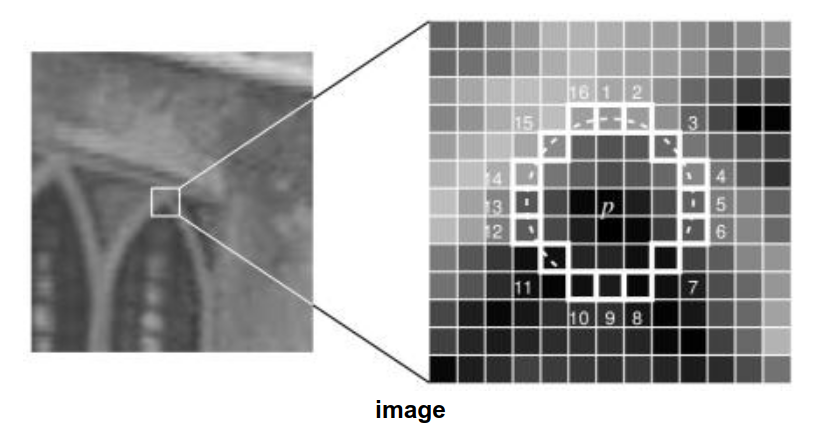

3. If the intensity **n** pixels of the pixels along the circle satisfy any of the following properties, then we say that this area has a corner:
$$I(x', y') > I(x, y) + \lambda_{x, y}$$
$$I(x', y') < I(x, y) - \lambda_{x, y}$$

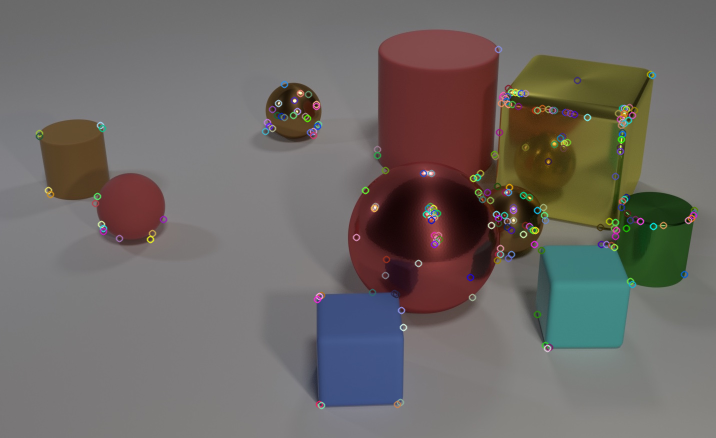

In [45]:
img_clevr = cv2.imread('clevr.jpg', cv2.IMREAD_COLOR)
img_clevr = cv2.resize(img_clevr, None, fx=0.5, fy=0.5)
img_clevr_gray = cv2.cvtColor(img_clevr, cv2.COLOR_BGR2GRAY)

fast = cv2.FastFeatureDetector_create()
kp = fast.detect(img_clevr_gray, None)

img_clevr = cv2.drawKeypoints(img_clevr, kp, None, flags=cv2.DRAW_MATCHES_FLAGS_DEFAULT)
imshow(img_clevr)

### ORB - Oriented FAST and Rotated BRIEF

An algorithm that combines the approach proposed by FAST and BRIEF. Presented in ORB: An efficient alternative to SIFT or SURF by Ethan Rublee, Vincent Rabaud, Kurt Konolige and Gary R. Bradski.

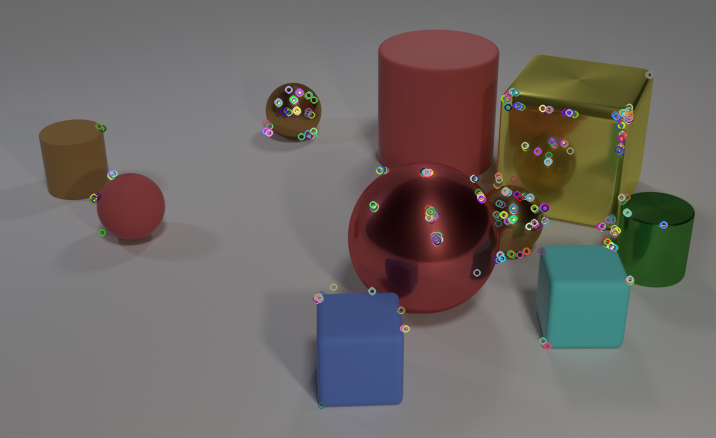

(465, 32)
[ 50  77  98 190  86 128 238 246 212   0 216  66  49 203 177  64 120 234
  19 203 200 187   6 255  48  36 170 136  61 187 112 168]


In [46]:
img_clevr = cv2.imread('clevr.jpg', cv2.IMREAD_COLOR)
img_clevr = cv2.resize(img_clevr, None, fx=0.5, fy=0.5)
img_clevr_gray = cv2.cvtColor(img_clevr, cv2.COLOR_BGR2GRAY)

orb = cv2.ORB_create()
kp, desc = orb.detectAndCompute(img_clevr_gray, None)

img_clevr = cv2.drawKeypoints(img_clevr, kp, None, flags=cv2.DRAW_MATCHES_FLAGS_DEFAULT)
imshow(img_clevr)

print(desc.shape)
print(desc[0])

## Matching descriptors

The matching of key points is done on the basis of their descriptors. OpenCV includes an object implementation to find both best and k-best matches.

In order to obtain correct results, the appropriate descriptor similarity function should be used. For descriptors that operate in the Euclidean space, this may be the normal Euclidean distance. For descriptors such as BRISK, which produce binary descriptors, the Hamming distance would be a better proposition.


Let's load two sample images that show the same object from different angles:

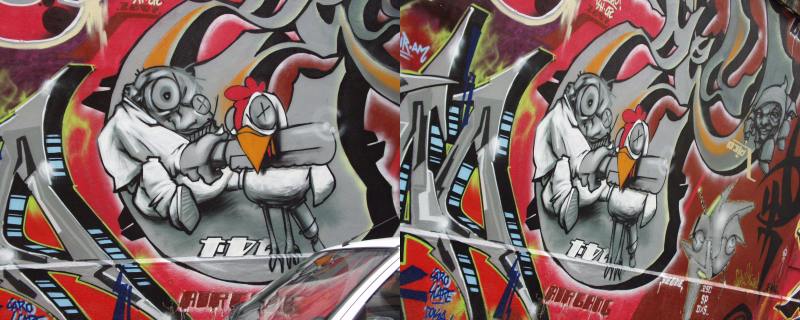

In [47]:
img_graf1 = cv2.imread('graf1.png', cv2.IMREAD_COLOR)
img_graf1 = cv2.resize(img_graf1, None, fx=0.5, fy=0.5)

img_graf2 = cv2.imread('graf2.png', cv2.IMREAD_COLOR)
img_graf2 = cv2.resize(img_graf2, None, fx=0.5, fy=0.5)

imshow(np.concatenate([img_graf1, img_graf2], 1))

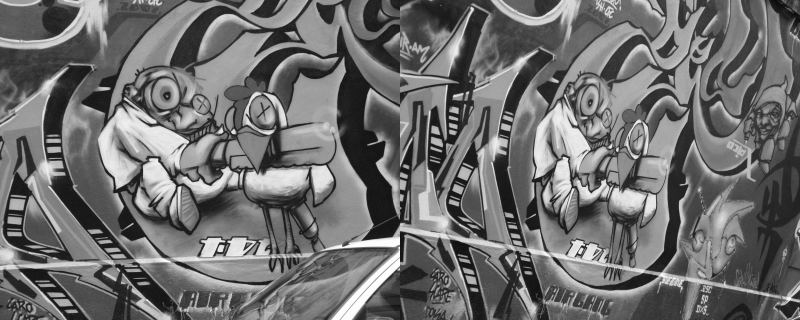

In [48]:
img_graf1_gray = cv2.cvtColor(img_graf1, cv2.COLOR_BGR2GRAY)
img_graf2_gray = cv2.cvtColor(img_graf2, cv2.COLOR_BGR2GRAY)

imshow(np.concatenate([img_graf1_gray, img_graf2_gray], 1))

Then, for their representation in the Grayscale color space, let's find the key points and their descriptors using the algorithms below.

In [49]:
sift = cv2.SIFT_create()  # kp + desc
orb = cv2.ORB_create()  # kp + desc
fast = cv2.FastFeatureDetector_create()  # only kp
star = cv2.xfeatures2d.StarDetector_create()  # only kp
brief = cv2.xfeatures2d.BriefDescriptorExtractor_create()  # only desc

In [50]:
sift_kp1, sift_desc1 = sift.detectAndCompute(img_graf1_gray, None)
sift_kp2, sift_desc2 = sift.detectAndCompute(img_graf2_gray, None)

orb_kp1, orb_desc1 = orb.detectAndCompute(img_graf1_gray, None)
orb_kp2, orb_desc2 = orb.detectAndCompute(img_graf2_gray, None)

fast_kp1 = fast.detect(img_graf1_gray, None)
fast_kp2 = fast.detect(img_graf2_gray, None)

star_kp1 = star.detect(img_graf1_gray, None)
star_kp2 = star.detect(img_graf2_gray, None)

print('\nSIFT:')
print('Number of key points in the first image:', len(sift_kp1))
print('Number of key points in the second image:', len(sift_kp2))

print('\nORB:')
print('Number of key points in the first image:', len(orb_kp1))
print('Number of key points in the second image:', len(orb_kp2))

print('\nFAST:')
print('Number of key points in the first image:', len(fast_kp1))
print('Number of key points in the second image:', len(fast_kp2))

print('\nSTAR:')
print('Number of key points in the first image:', len(star_kp1))
print('Number of key points in the second image:', len(star_kp2))


SIFT:
Number of key points in the first image: 1093
Number of key points in the second image: 1322

ORB:
Number of key points in the first image: 500
Number of key points in the second image: 500

FAST:
Number of key points in the first image: 3007
Number of key points in the second image: 3571

STAR:
Number of key points in the first image: 282
Number of key points in the second image: 325


In [51]:
def show_kp(kp1, kp2):
  img_kp1 = cv2.drawKeypoints(img_graf1, kp1, None, flags=cv2.DRAW_MATCHES_FLAGS_DEFAULT)
  img_kp2 = cv2.drawKeypoints(img_graf2, kp2, None, flags=cv2.DRAW_MATCHES_FLAGS_DEFAULT)

  imshow(np.concatenate([img_kp1, img_kp2], 1))


SIFT Keypoints:



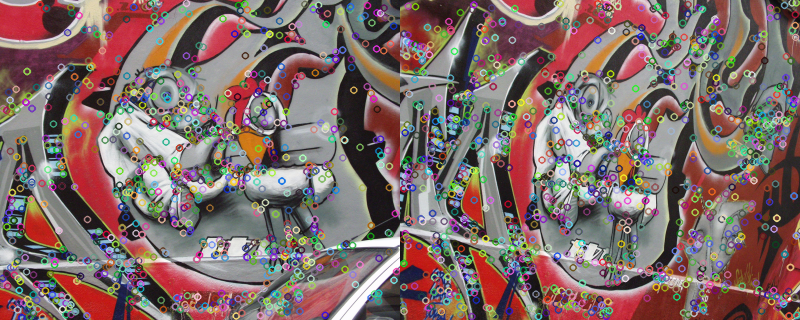


ORB Keypoints:



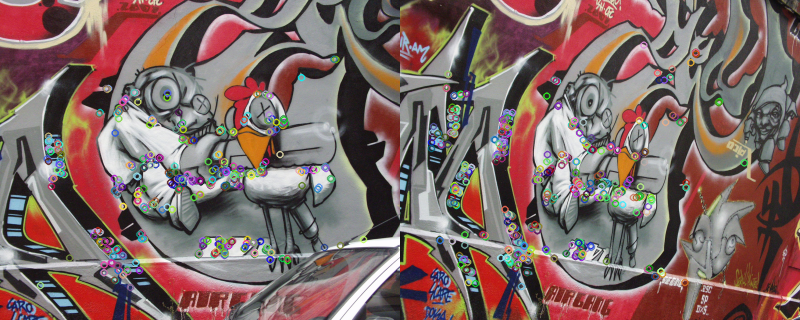


FAST Keypoints:



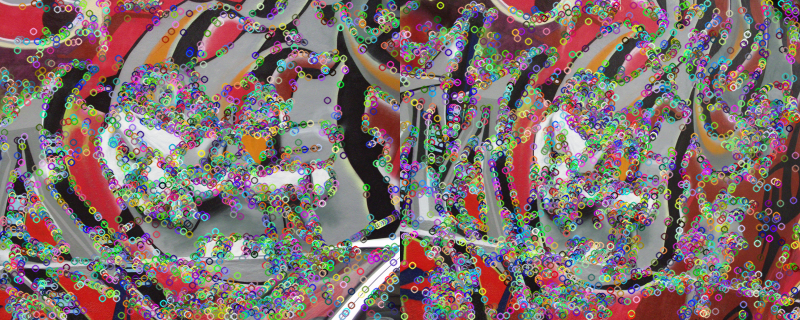


STAR Keypoints:



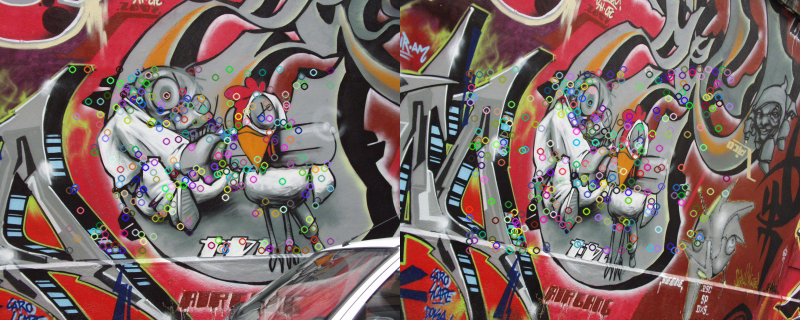

In [52]:
print('\nSIFT Keypoints:\n')
show_kp(sift_kp1, sift_kp2)

print('\nORB Keypoints:\n')
show_kp(orb_kp1, orb_kp2)

print('\nFAST Keypoints:\n')
show_kp(fast_kp1, fast_kp2)

print('\nSTAR Keypoints:\n')
show_kp(star_kp1, star_kp2)

Additionally, for the FAST and STAR key points, let's count the BRIEF descriptors.

In [53]:
_, fast_brief_desc1 = brief.compute(img_graf1_gray, fast_kp1)
_, fast_brief_desc2 = brief.compute(img_graf2_gray, fast_kp2)

_, star_brief_desc1 = brief.compute(img_graf1_gray, star_kp1)
_, star_brief_desc2 = brief.compute(img_graf2_gray, star_kp2)

For the above generated data, we will check the best fit as well as the k-nearest matches, based on Euclidean and Hamming distance.


In [54]:
bf_l2 = cv2.BFMatcher(cv2.NORM_L2)
bf_hamming = cv2.BFMatcher(cv2.NORM_HAMMING)

### Closest match

In [55]:
def show_matches(bf, kp1, desc1, kp2, desc2, num_matches=30):
  matches = bf.match(desc1, desc2)
  matches = sorted(matches, key = lambda x:x.distance)
  matches = cv2.drawMatches(img_graf1, kp1, img_graf2, kp2, matches[:num_matches], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
  imshow(matches)

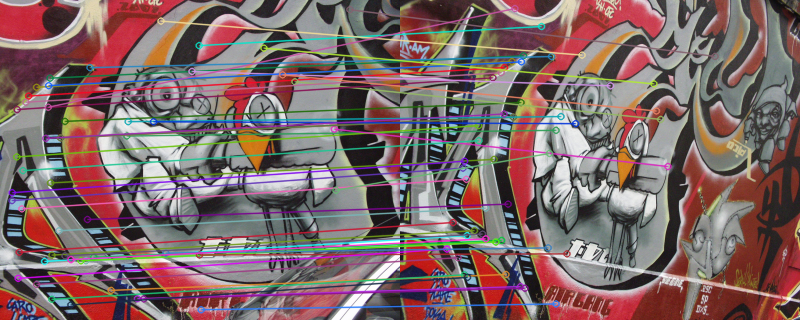

In [56]:
show_matches(bf_l2, sift_kp1, sift_desc1, sift_kp2, sift_desc2, 50)

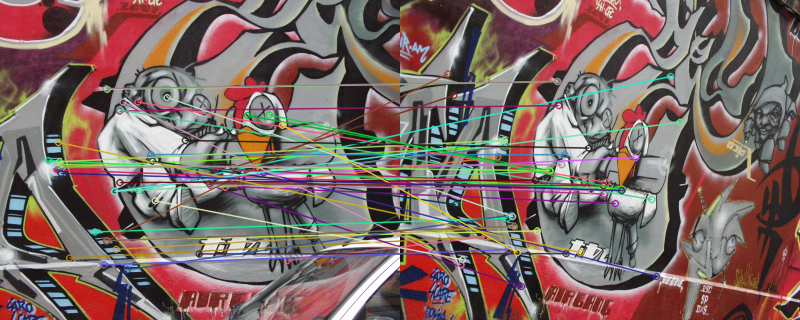

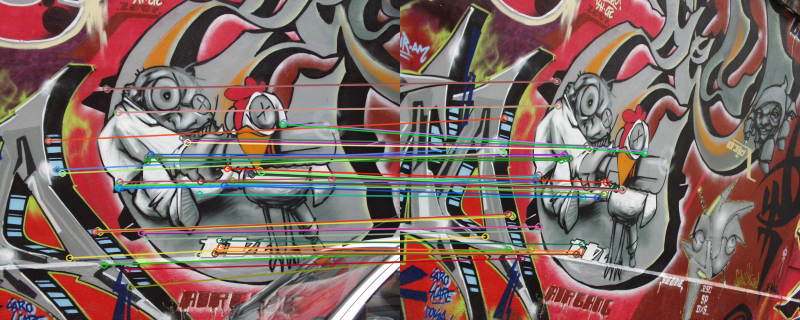

In [57]:
show_matches(bf_l2, orb_kp1, orb_desc1, orb_kp2, orb_desc2, 50)
show_matches(bf_hamming, orb_kp1, orb_desc1, orb_kp2, orb_desc2, 50)

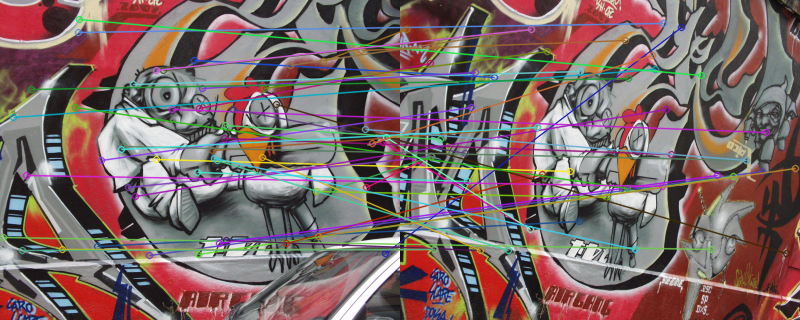

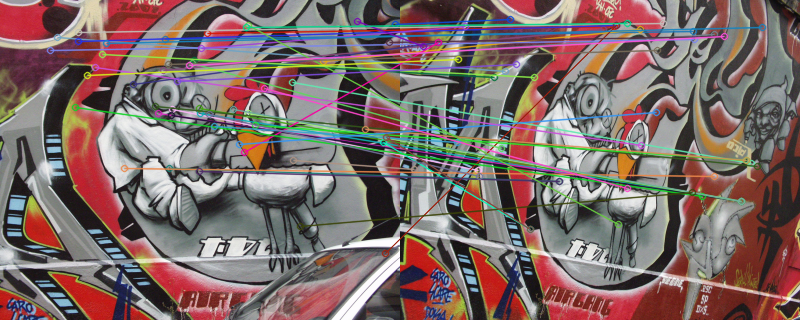

In [58]:
show_matches(bf_l2, fast_kp1, fast_brief_desc1, fast_kp2, fast_brief_desc2, 50)
show_matches(bf_hamming, fast_kp1, fast_brief_desc1, fast_kp2, fast_brief_desc2, 50)

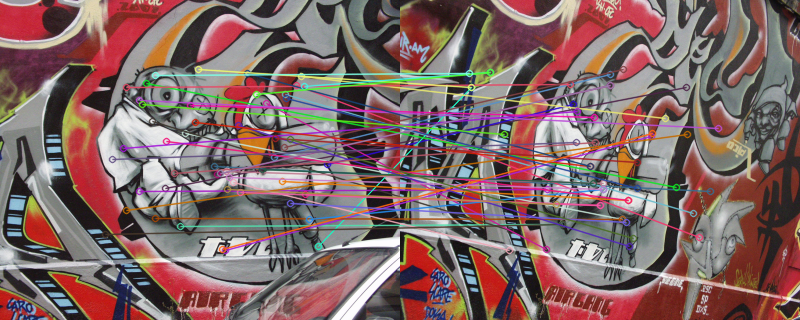

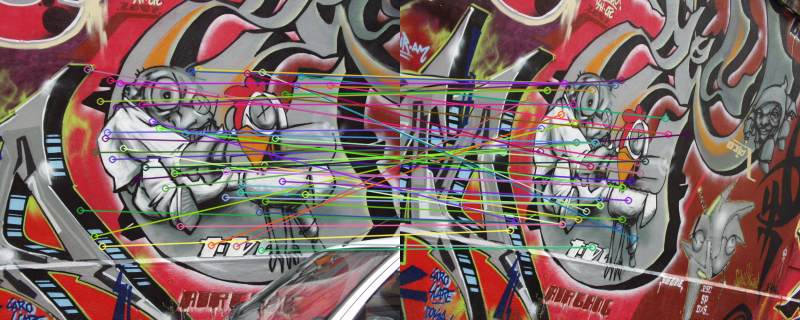

In [59]:
show_matches(bf_l2, star_kp1, star_brief_desc1, star_kp2, star_brief_desc2, 50)
show_matches(bf_hamming, star_kp1, star_brief_desc1, star_kp2, star_brief_desc2, 50)

### K-nearest matches

In [60]:
def show_knn_matches(bf, kp1, desc1, kp2, desc2, num_matches=30, k=2):
  matches = bf.knnMatch(desc1, desc2, k=k)
  # taking k = 2 you can use additional filtering described in the article on SIFT
  matches = [[m] for m, n in matches if m.distance < 0.75*n.distance]
  matches = cv2.drawMatchesKnn(img_graf1, kp1, img_graf2, kp2, matches[:num_matches], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
  imshow(matches)

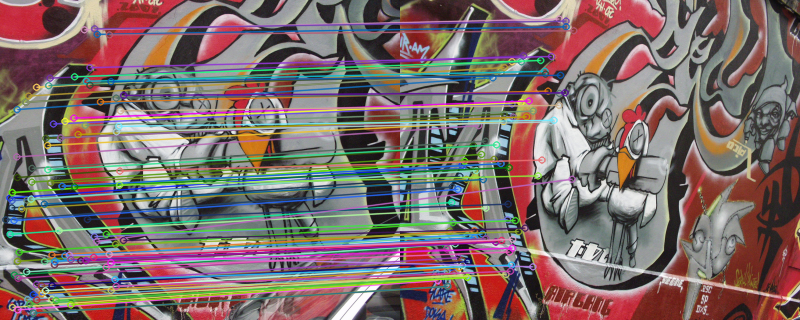

In [61]:
show_knn_matches(bf_l2, sift_kp1, sift_desc1, sift_kp2, sift_desc2, 100)

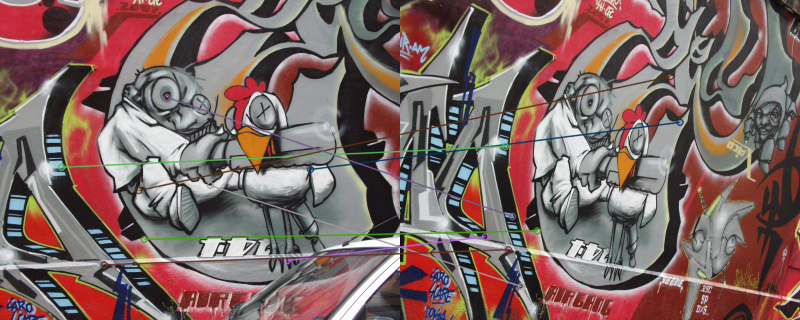

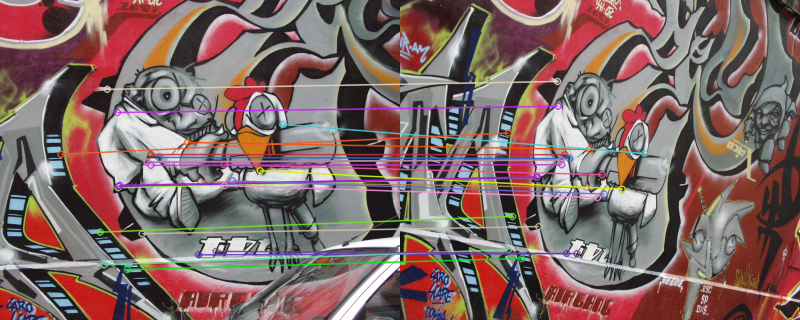

In [62]:
show_knn_matches(bf_l2, orb_kp1, orb_desc1, orb_kp2, orb_desc2, 50)
show_knn_matches(bf_hamming, orb_kp1, orb_desc1, orb_kp2, orb_desc2, 50)

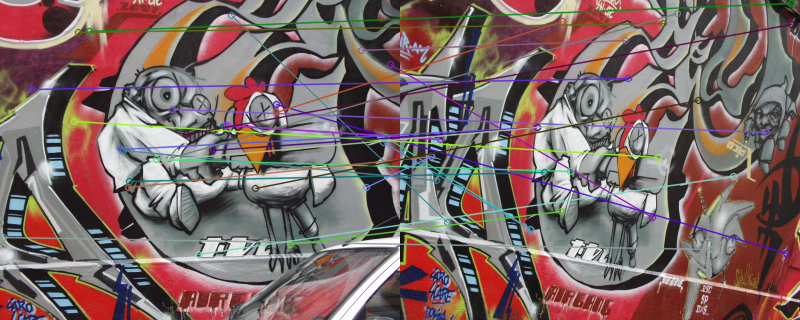

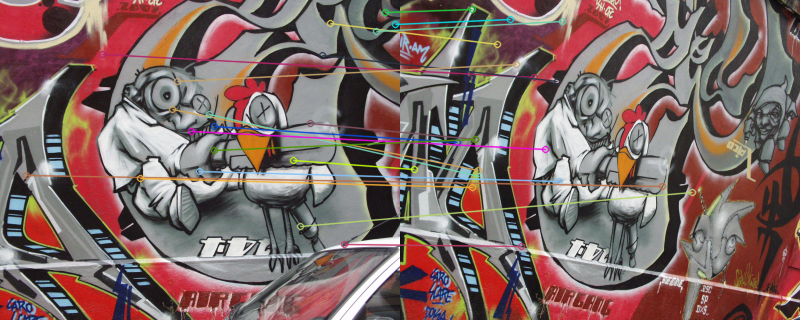

In [63]:
show_knn_matches(bf_l2, fast_kp1, fast_brief_desc1, fast_kp2, fast_brief_desc2, 50)
show_knn_matches(bf_hamming, fast_kp1, fast_brief_desc1, fast_kp2, fast_brief_desc2, 50)

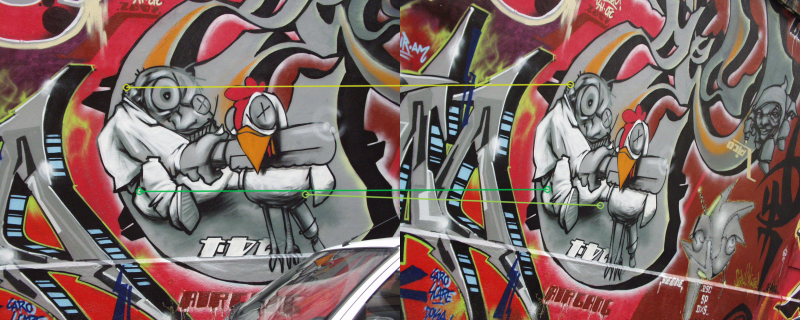

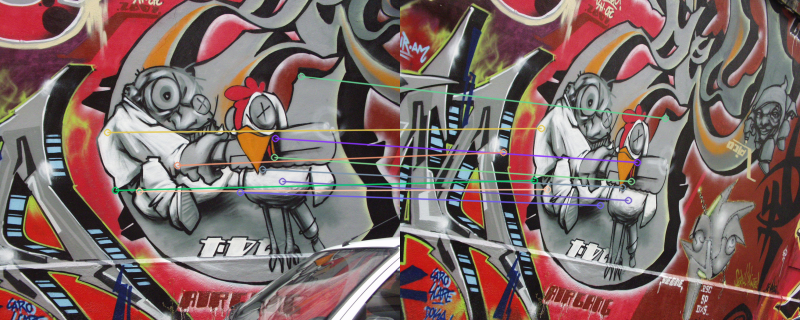

In [64]:
show_knn_matches(bf_l2, star_kp1, star_brief_desc1, star_kp2, star_brief_desc2, 50)
show_knn_matches(bf_hamming, star_kp1, star_brief_desc1, star_kp2, star_brief_desc2, 50)

## Task 3

Implement an algorithm that will find the most similar images to your query. The algorithm should work for any key point detector (a descriptor with a key point detection function) and a descriptor (an object that returns its descriptor for a given key point).

Use the Cats and Dogs (Microsoft) dataset available on the [site] (https://www.microsoft.com/en-us/download/details.aspx?id=54765) (or use the download instructions in the code below ).

Sub-items to be performed:
- create a data set by choosing 20 images of cats and dogs randomly,
- create a query by selecting a random image of a dog or cat (this image should not be included in the above set),
- write an algorithm to determine the similarity of the query and all images in the data set,
- run an algorithm that will find the 5 most similar images,
- check how many of the found photos are of the same class as the inquiries (cat vs dog),
- compare the results for at least 2 descriptors.
- you can propose your own key point detector or descriptor, in this case add comments describing the next stages of processing.



In [ ]:
## The link provided below is invalid
# !wget -O cats_and_dogs.zip https://download.microsoft.com/download/3/E/1/3E1C3F21-ECDB-4869-8368-6DEBA77B919F/kagglecatsanddogs_3367a.zip

## Therefore, I have decided to upload the dataset manually to my personal Google Drive
!wget --no-check-certificate https://drive.google.com/u/0/uc\?id\=1jO_izVWbhTa828Rlgjdj6h3I8UnSYrk2\&export\=download -O cats_and_dogs.zip
!unzip -o cats_and_dogs.zip

Query Pet - Dog


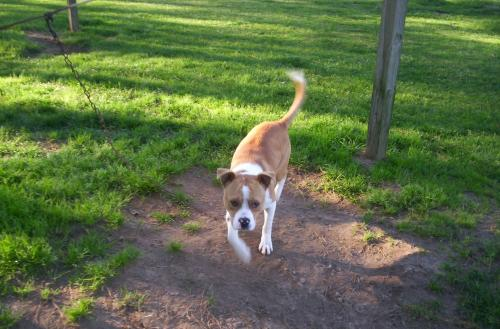

In [442]:
import os
from os import path

def detect_and_compute(img, desc1=None, desc2=None):
    img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    if desc1 in [sift, orb]:
        kp, desc = desc1.detectAndCompute(img, None)
    if desc1 in [star, brief]:
        kp = desc1.detect(img_gray, None)
        kp, desc = desc2.compute(img_gray, kp)
        
    return desc

def get_similarity(img1, img2, *, desc1=None, desc2=None, bf=None):
    matches = bf.knnMatch(detect_and_compute(img1, desc1, desc2), detect_and_compute(img2, desc1, desc2), k=2)
    matches = [[m] for m, n in matches if m.distance < 0.75 * n.distance]

    return len(matches)

def get_compared(dataset, img, **kwargs):
    compared = [get_similarity(x, img, **kwargs) for x in dataset]
    result = sorted(range(len(compared)), key=lambda x: compared[x])[::-1]
    return result, compared


folders = ['./PetImages/Cat', './PetImages/Dog']
query_folder = random.choice(folders)
query_pet = path.join(query_folder, random.choice(os.listdir(query_folder)))
pet_dataset = {path.join(folder, image): cv2.imread(path.join(folder, image), cv2.IMREAD_COLOR) for folder in folders for image in random.sample(os.listdir(folder), 20) if path.join(folder, image) != query_pet}
query_pet_type = os.path.basename(query_folder)
query_pet = cv2.imread(query_pet, cv2.IMREAD_COLOR)

print('Query Pet -', query_pet_type)
imshow(query_pet)

All similarity values (ORB - ORB applied): [3, 4, 5, 2, 1, 8, 1, 5, 2, 2, 4, 7, 1, 2, 4, 4, 1, 2, 8, 7, 5, 6, 3, 3, 3, 7, 1, 0, 4, 1, 4, 4, 3, 2, 1, 4, 5, 1, 4, 4] 


Similarity: 8
Cat


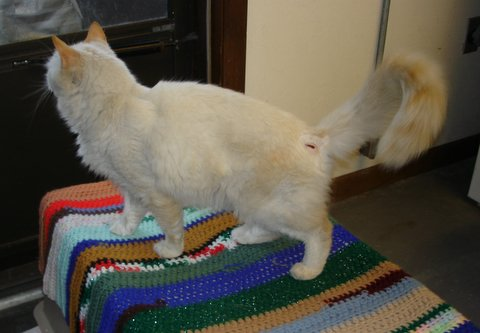


Similarity: 8
Cat


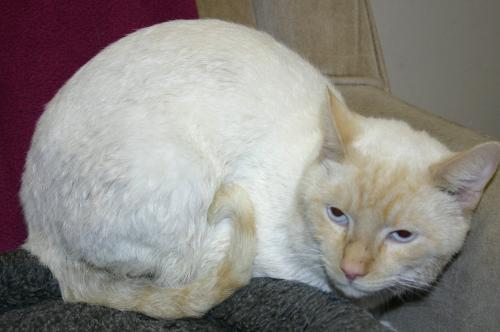


Similarity: 7
Dog


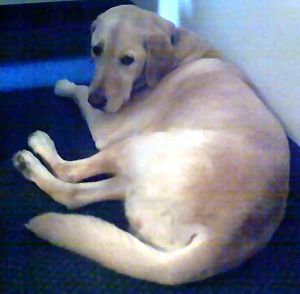


Similarity: 7
Cat


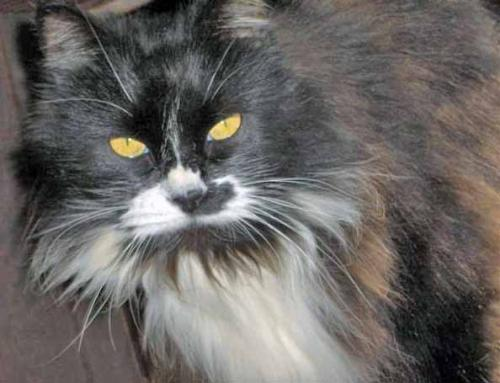


Similarity: 7
Cat


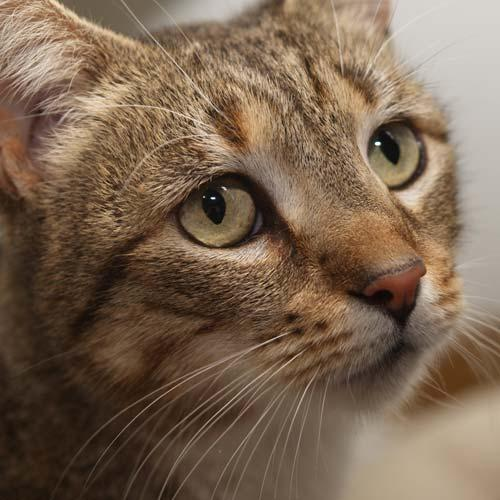

In [443]:
orb_orb = get_compared(list(pet_dataset.values()), query_pet, desc1=orb, desc2=orb, bf=bf_hamming)
print(f'All similarity values (ORB - ORB applied): {orb_orb[1]} \n')

res_orb_orb = []
for x in orb_orb[0][:5]:
    print('\nSimilarity:', orb_orb[1][x])
    pet = os.path.basename(os.path.dirname(list(pet_dataset.keys())[x]))
    res_orb_orb.append(pet)
    print(pet)
    imshow(list(pet_dataset.values())[x])

All similarity values (STAR - BRIEF applied): [4, 0, 27, 2, 8, 1, 5, 3, 0, 2, 3, 6, 11, 2, 5, 5, 4, 0, 3, 6, 5, 3, 4, 1, 6, 1, 0, 4, 8, 13, 3, 6, 12, 0, 1, 4, 2, 3, 7, 5] 

Similarity: 27
Cat


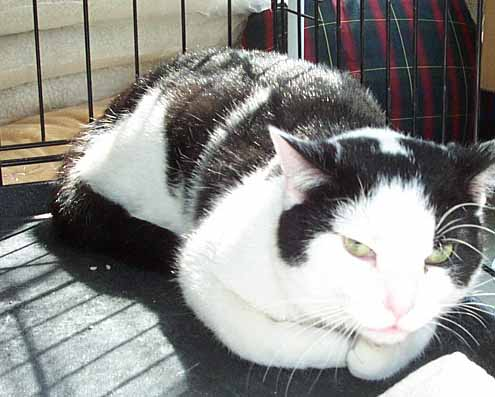

Similarity: 13
Dog


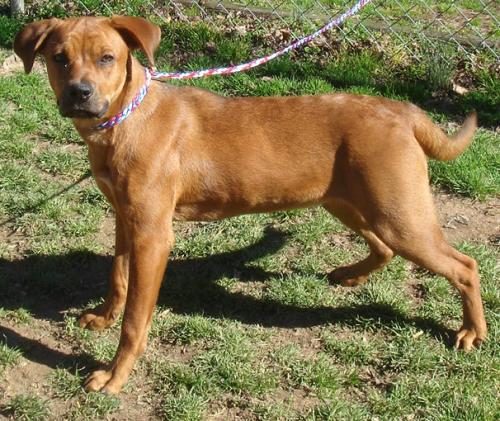

Similarity: 12
Dog


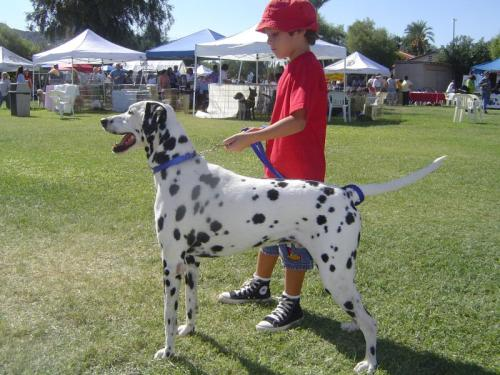

Similarity: 11
Cat


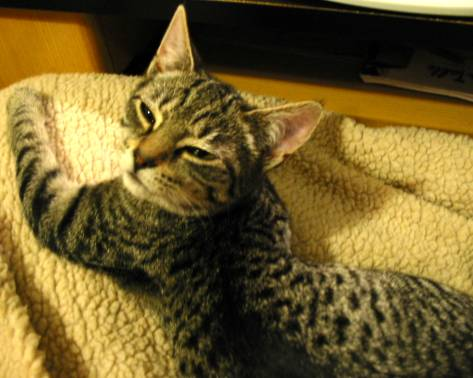

Similarity: 8
Dog


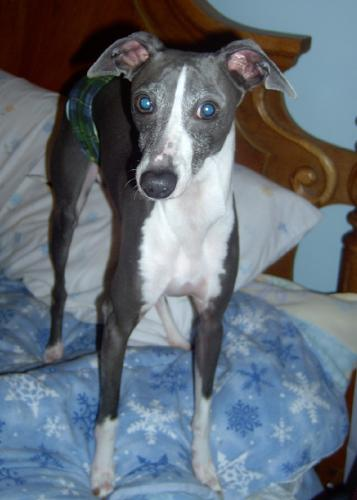

In [444]:
star_brief = get_compared(list(pet_dataset.values()), query_pet, desc1=star, desc2=brief, bf=bf_hamming)
print(f'All similarity values (STAR - BRIEF applied): {star_brief[1]} \n')

res_star_brief = []
for x in star_brief[0][:5]:
    print('Similarity:', star_brief[1][x])
    pet = os.path.basename(os.path.dirname(list(pet_dataset.keys())[x]))
    res_star_brief.append(pet)
    print(pet)
    imshow(list(pet_dataset.values())[x])

All similarity values (SIFT - SIFT applied): [11, 0, 24, 6, 3, 3, 2, 9, 4, 2, 2, 2, 10, 2, 5, 5, 7, 2, 7, 5, 3, 4, 4, 10, 4, 4, 1, 8, 4, 7, 6, 6, 15, 0, 4, 2, 15, 3, 9, 0] 

Similarity: 24
Cat


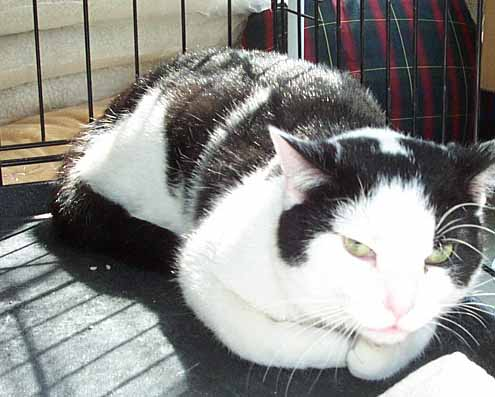

Similarity: 15
Dog


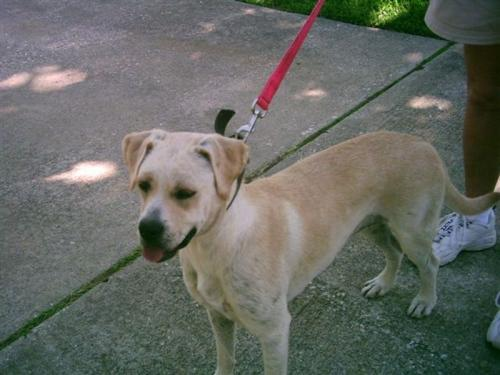

Similarity: 15
Dog


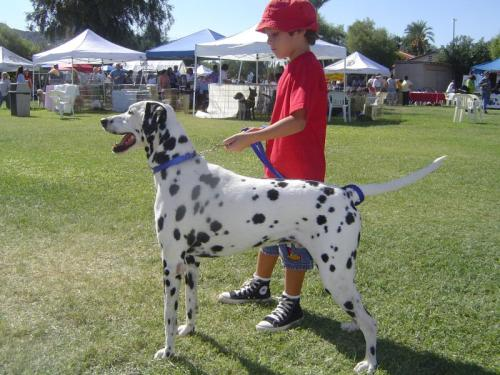

Similarity: 11
Cat


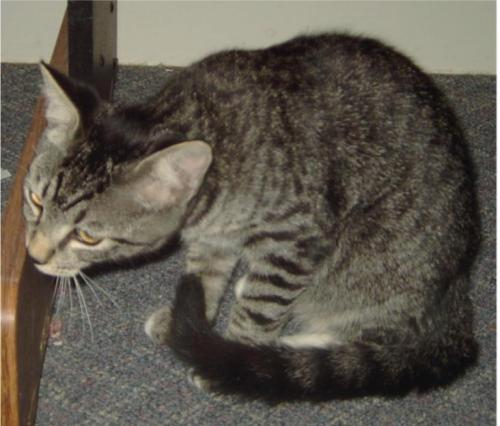

Similarity: 10
Dog


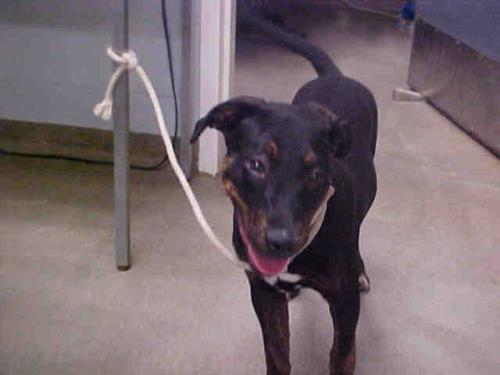

In [445]:
sift_sift = get_compared(list(pet_dataset.values()), query_pet, desc1=sift, desc2=sift, bf=bf_l2)
print(f'All similarity values (SIFT - SIFT applied): {sift_sift[1]} \n')

res_sift_sift = []
for x in sift_sift[0][:5]:
    print('Similarity:', sift_sift[1][x])
    pet = os.path.basename(os.path.dirname(list(pet_dataset.keys())[x]))
    res_sift_sift.append(pet)
    print(pet)
    imshow(list(pet_dataset.values())[x])

Ratio of correctly guessed labels for each of the selected descriptor combinations.

The results are usually relatively the same. In that particular run though, the worst results were obtained by ORB. 

However, it is worth mentioning that in case of query image being a cat, the performance of each descriptor is much worse.

In [446]:
print('ORB - ORB applied: ', res_orb_orb.count(query_pet_type) / 5)
print('STAR - BRIEF applied: ', res_star_brief.count(query_pet_type) / 5)
print('SIFT - SIFT applied: ', res_sift_sift.count(query_pet_type) / 5)

ORB - ORB applied:  0.2
STAR - BRIEF applied:  0.6
SIFT - SIFT applied:  0.6
